## 1. Camera calibration

In this Section I will calibrate the camera using the picture containing chessboard.

In [1]:
import numpy as np
import cv2 
import matplotlib.pyplot as plt
import matplotlib.image as mping

## generate vectors to hold the cross points

img_points = [] # real points in the figure
obj_points = []

objp = np.zeros((6*9,3), np.float32) # desired points
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

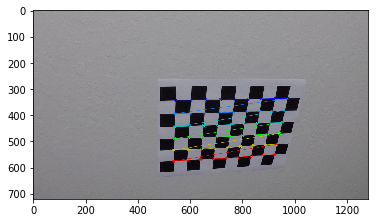

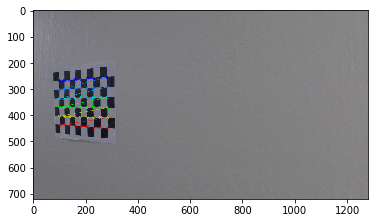

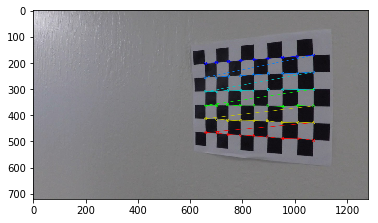

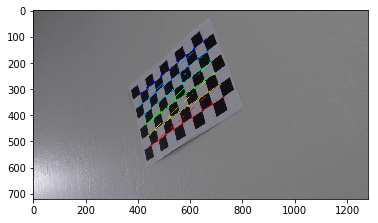

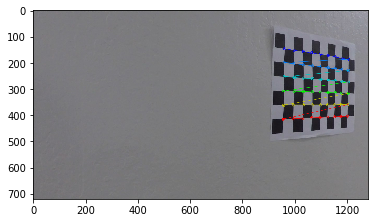

...

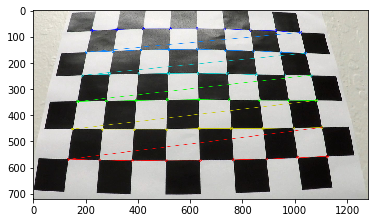

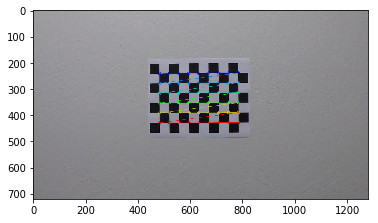

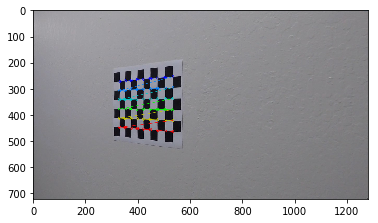

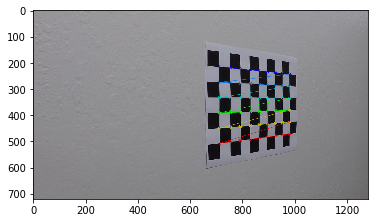

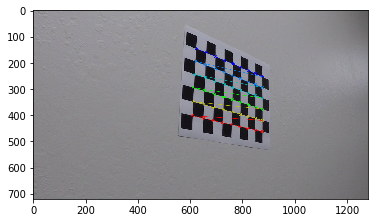

In [2]:
## read in all the images using glob API and find chessboard corners
import glob

images = glob.glob('.\camera_cal\calibration*.jpg')

for file in images:
    # read the image
    image = mping.imread(file)
    
    # gray scale the image   
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # if found, add the object and image points 
    if ret:
        img_points.append(corners)
        obj_points.append(objp)
        
        # draw the corners in the picture and display it
        plt.figure()
        image = cv2.drawChessboardCorners(image, (9,6), corners, ret)
        plt.imshow(image)
        figurename = file.split("\\")[-1]
#         cv2.imwrite(".\output_images\calibration\chessboardcorners_" + figurename,image)


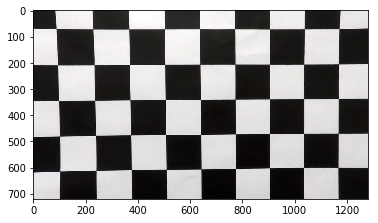

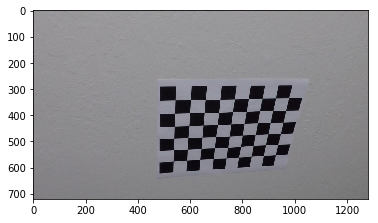

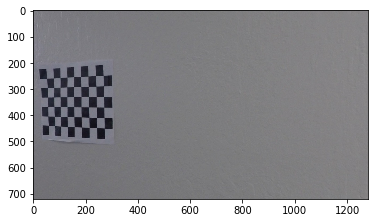

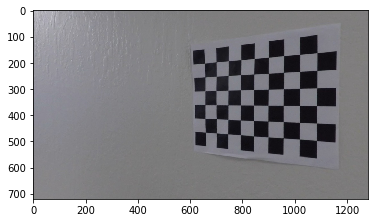

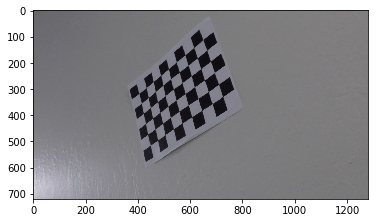

...

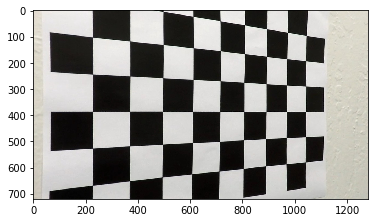

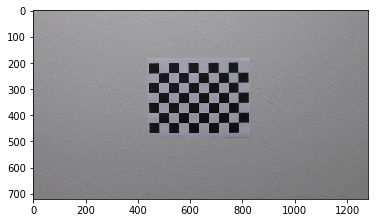

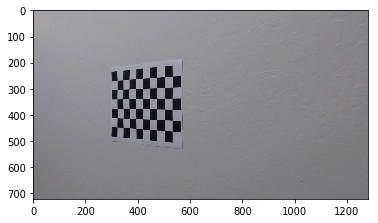

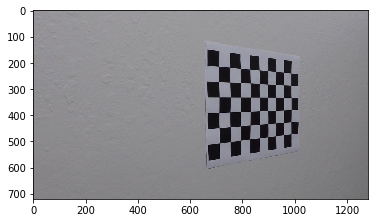

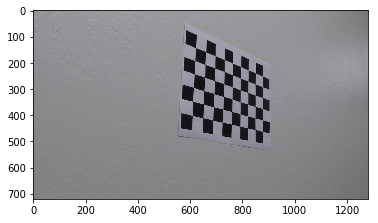

In [3]:
## define a fuction to calibrate and undistort the pictures from this camera

def cal_undistort(image, img_points, obj_points):
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, gray.shape[::-1], None, None)
    
    return cv2.undistort(image, mtx, dist, None, mtx)

## test the calibration function

for file in images:
    image = mping.imread(file)
    image = cal_undistort(image, img_points, obj_points)
    plt.figure()
    plt.imshow(image)
    figurename = file.split("\\")[-1]
#     cv2.imwrite(".\output_images\calibration\\" + figurename, image)

## 2. Transform the pictures into bird-eye view

In this section I will undistort and transform the picture into bird-eye view buy selecting four tranform points and define four target points

(720, 1280, 3)


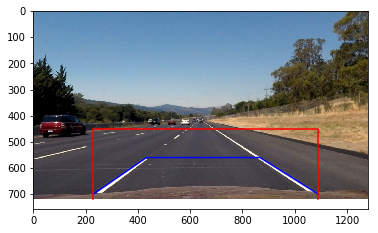

In [4]:
## transform the picture

# read in the picture, undistort it and find the transform points
image = mping.imread("./test_images/straight_lines2.jpg")
image = cal_undistort(image, img_points, obj_points)
plt.imshow(image)

plot_point = [[230,433,867,1090], [700,560,560,700]]
wrap_point = [[230,230,1090,1090], [720,450,450,720]]
plt.plot(plot_point[0], plot_point[1], 'b')
plt.plot(wrap_point[0],wrap_point[1], 'r')
print(image.shape)

True

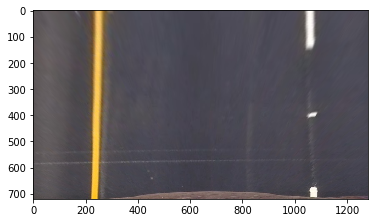

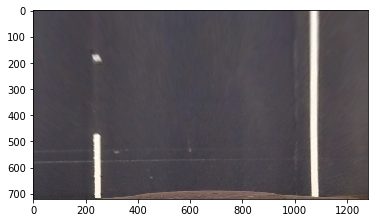

In [5]:
## transform the pictures and save it

def wrap(img):
    src = np.float32([[230,700], [433,560], [867,560], [1090,700]])
    dst = np.float32([[230,720], [230,450], [1090,450], [1090, 720]])
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    wraped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return wraped

# test in two straight lines
plt.figure()
image = cv2.imread("./test_images/straight_lines1.jpg")
image = cal_undistort(image, img_points, obj_points)
plt.imshow(cv2.cvtColor(wrap(image), cv2.COLOR_RGB2BGR))
cv2.imwrite("./output_images/undistort_and_tranform/straight_lines1.jpg", wrap(image))

plt.figure()
image = cv2.imread("./test_images/straight_lines2.jpg")
image = cal_undistort(image, img_points, obj_points)
plt.imshow(cv2.cvtColor(wrap(image), cv2.COLOR_RGB2BGR))
cv2.imwrite("./output_images/undistort_and_tranform/straight_lines2.jpg", wrap(image))


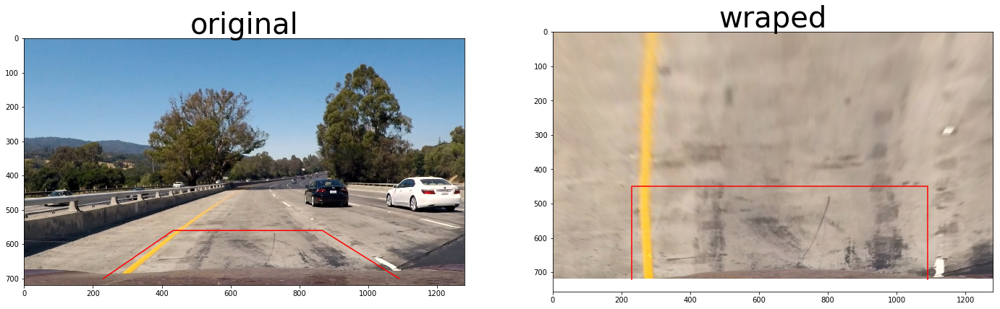

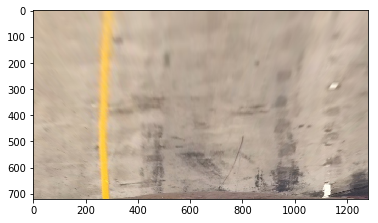

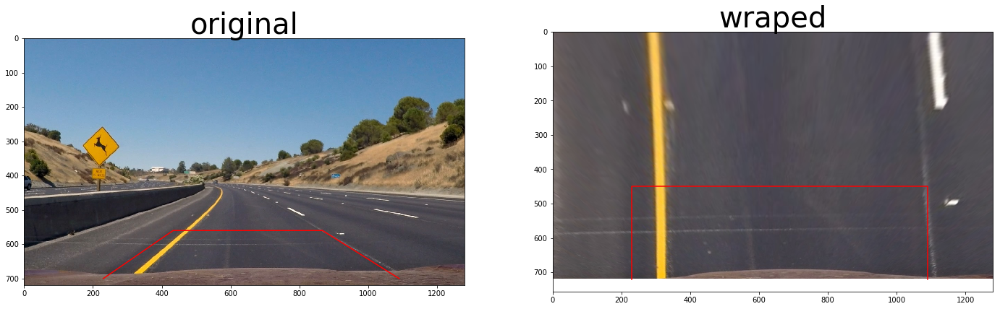

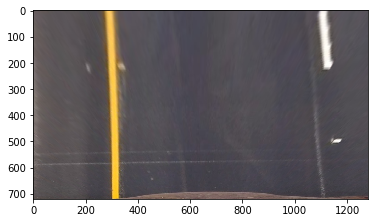

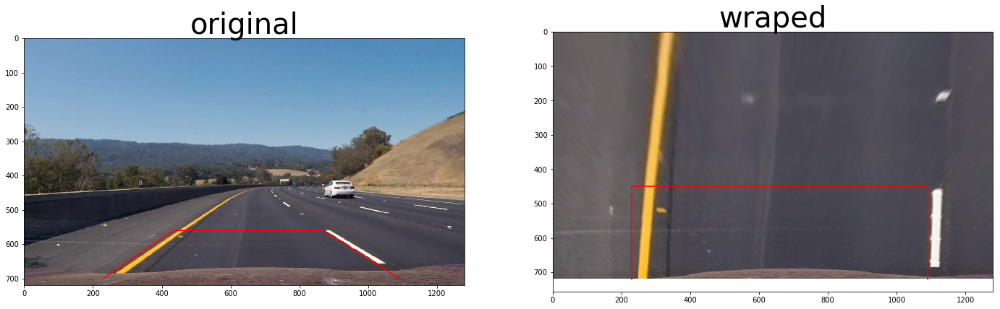

...

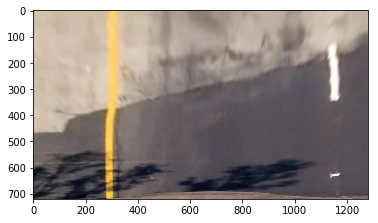

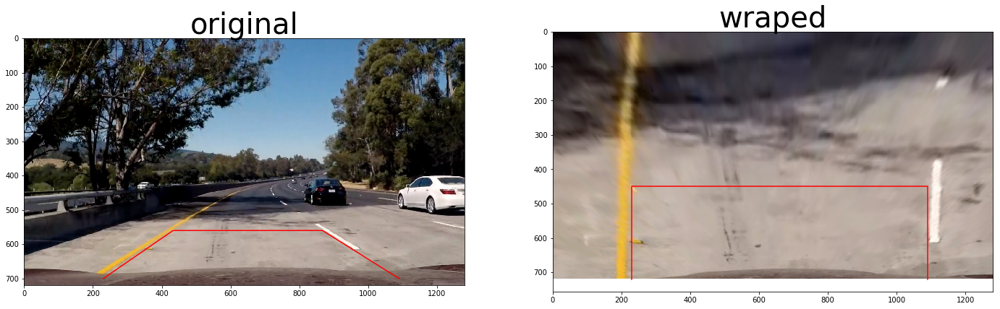

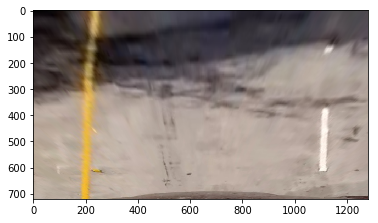

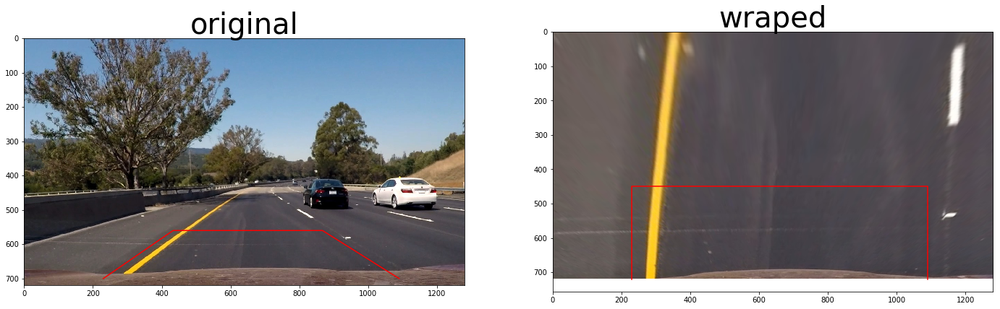

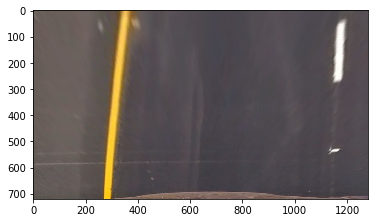

In [6]:
## test in all test case

images = glob.glob('./test_images/test*.jpg')

for file in images:
    image = mping.imread(file)
    figurename = file.split('\\')[-1]
    
    plt.figure(figsize=(24, 9))
    
    image = cal_undistort(image, img_points, obj_points)
    image = wrap(image)
    plt.subplot(1,2,2)
    plt.imshow(image)
    plt.plot(wrap_point[0],wrap_point[1], 'r')
    plt.subplot(1,2,2).set_title('wraped', fontsize=40)
    
    plt.subplot(1,2,1)
    plt.imshow(mping.imread(file))
    plt.plot(plot_point[0], plot_point[1], 'r')
    plt.subplot(1,2,1).set_title('original', fontsize=40)
    plt.savefig("./output_images/undistort_and_tranform/compare_" + figurename)
    
    plt.figure()
    plt.imshow(image)
    cv2.imwrite("./output_images/undistort_and_tranform/" + figurename, cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

## 3. Find the best channel to convert the picture preparing for finding the lane line

In this section I will try to convert the bird-eye view picture into gray scale, and the tree channels in HLS, then find a good combination of them with the help of Sobel function
This will make the task of finding lane line much more easier.

### Use sobel in gray scale

In [7]:
## try the threshold for grayscale
gray_thres = (70,200)

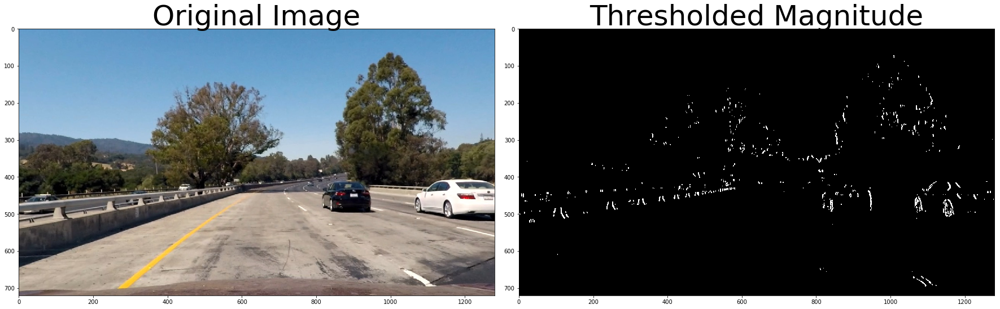

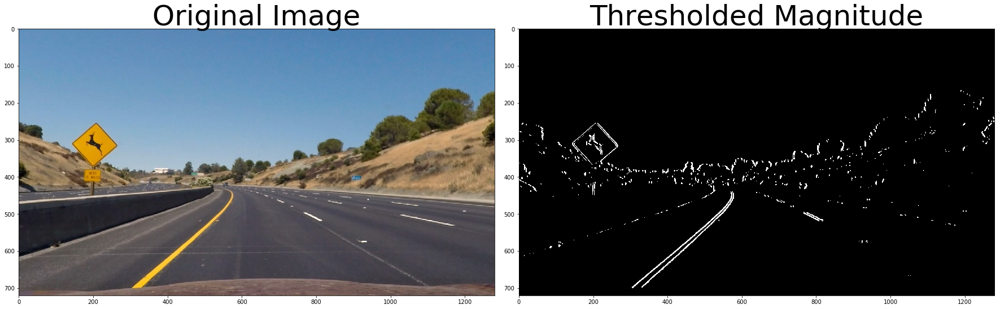

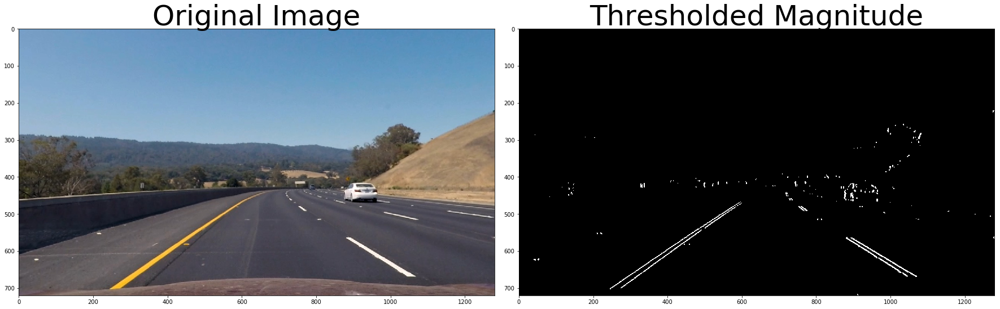

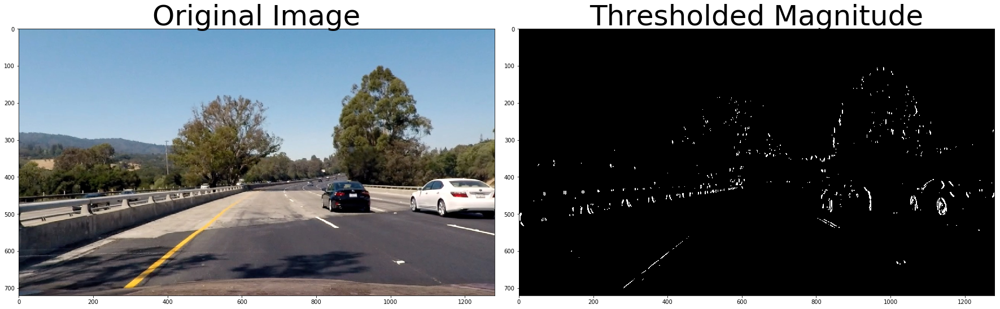

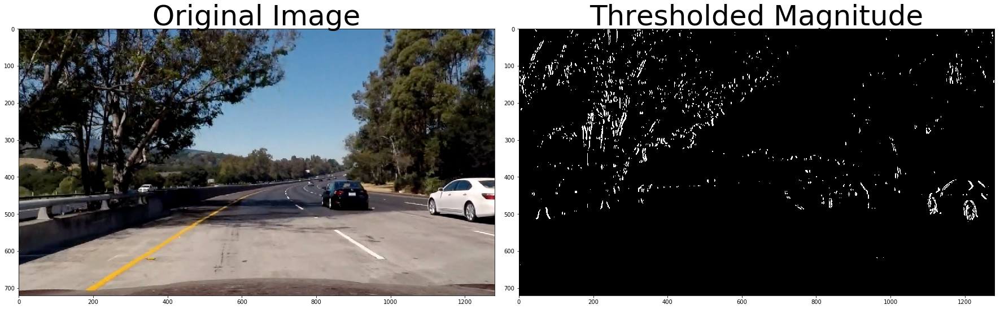

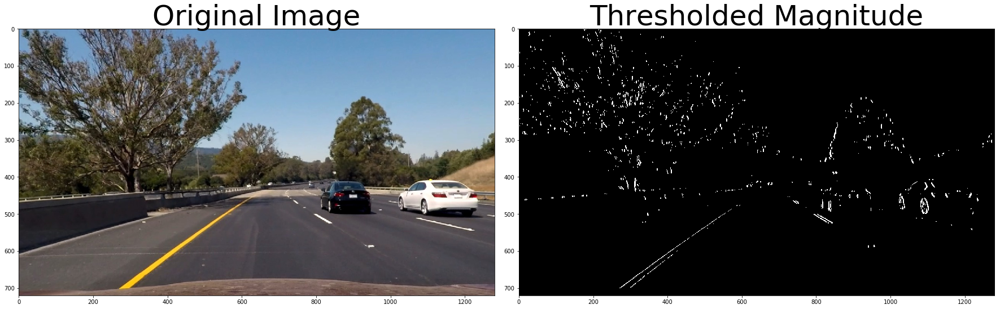

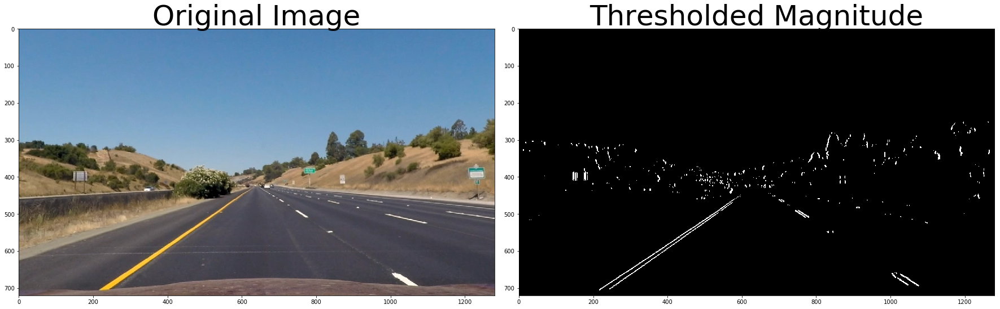

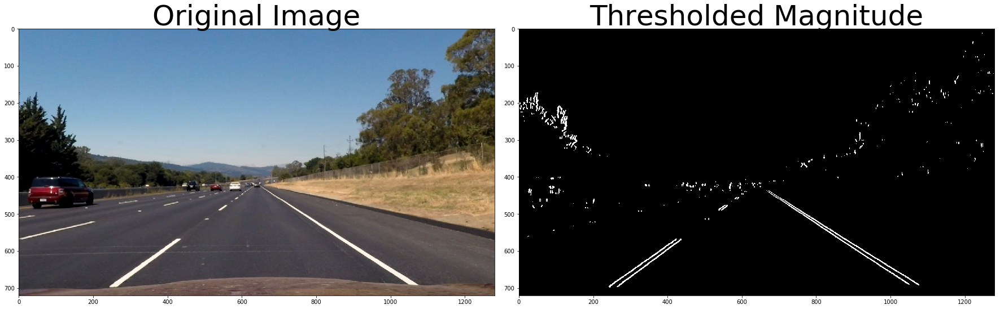

In [8]:
## define a function to convert the picture into binary 

def abs_sobel_binary(img, thres=(0,255), orient = 'x', sobel_kernel=3):
    # grayscale the image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # calculate the gradient in x and y direction
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # calculate the relevant value by demand
    if orient == 'x':
        img_sobel = np.abs(sobelx)
    elif orient == 'y':
        img_sobel = np.abs(sobely)
    elif orient == 'combined':
        img_sobel = np.sqrt(sobelx**2+sobely**2)
    else:
        raise Exception("Invalid orientation, please enter x, y or combined! ")
        
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*img_sobel/np.max(img_sobel))
    
    # implement the threshold
    binary_output = np.zeros_like(gray)
    binary_output[(scaled_sobel>=thres[0]) & (scaled_sobel<=thres[1])] = 1
    return binary_output

# test the function
images = glob.glob('./test_images/test*.jpg') + glob.glob('./test_images/straight_lines*.jpg')

for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    img_binary = abs_sobel_binary(image, thres=gray_thres, sobel_kernel=9)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(img_binary, cmap='gray')
    ax2.set_title('Thresholded Magnitude', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig('./output_images/binary/gray_compare_' + figurename)

    cv2.imwrite('./output_images/binary/gray_' + figurename, img_binary*255)

### Use sobel in HLS channels

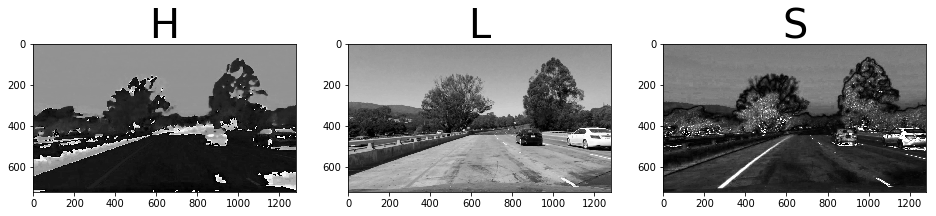

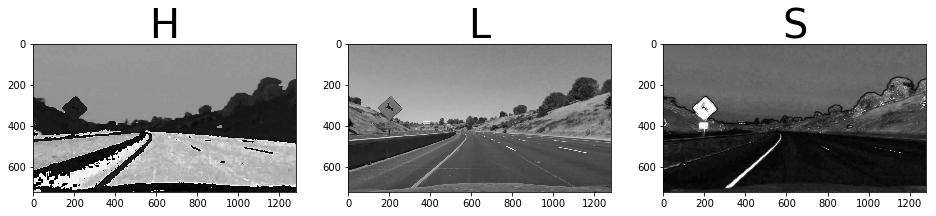

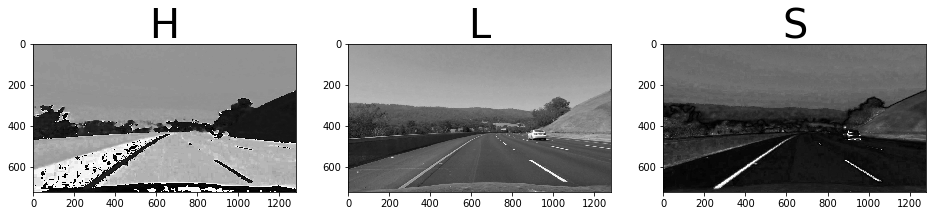

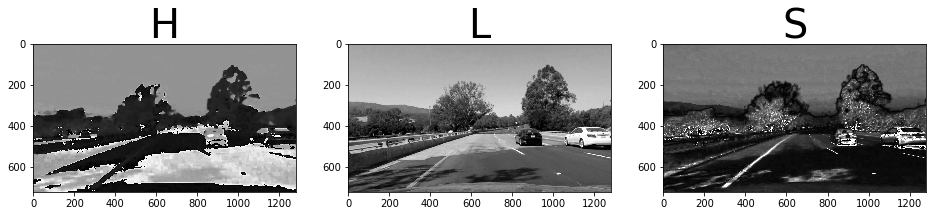

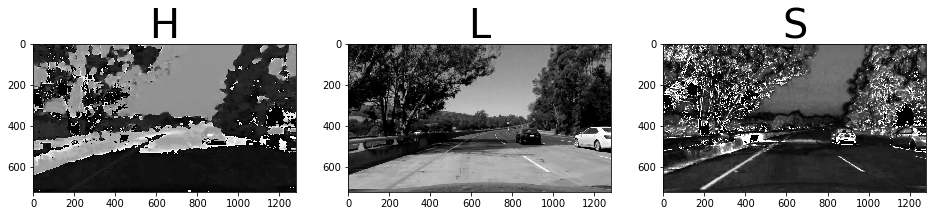

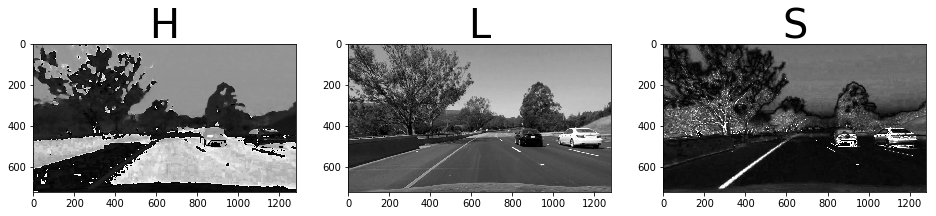

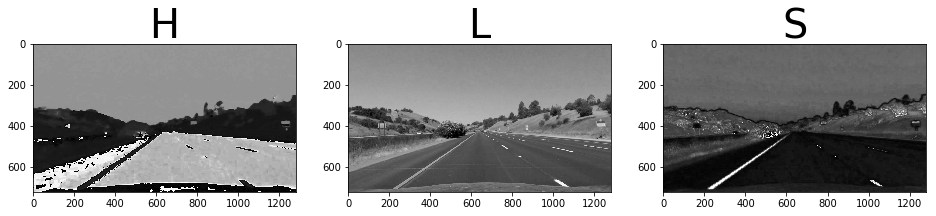

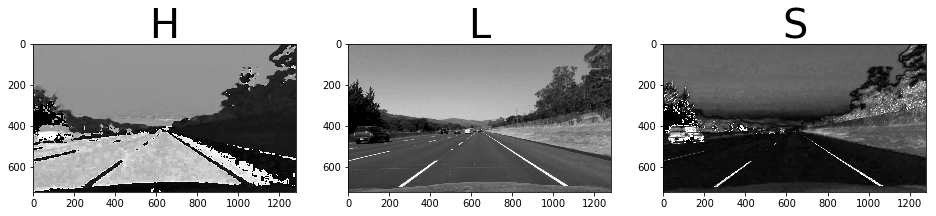

In [9]:
# read and translate the figure
for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    # show every channel in grayscale

    H = image[:,:,0]
    L = image[:,:,1]
    S = image[:,:,2]
    plt.figure(figsize=(16,6))
    plt.subplot(1,3,1)
    plt.imshow(H, cmap='gray')
    plt.subplot(1,3,1).set_title('H', fontsize=40)
    plt.subplot(1,3,2)
    plt.imshow(L, cmap='gray')
    plt.subplot(1,3,2).set_title('L', fontsize=40)
    plt.subplot(1,3,3)
    plt.imshow(S, cmap='gray')
    plt.subplot(1,3,3).set_title('S', fontsize=40)

    plt.savefig('./output_images/binary/HLS_channels_' + figurename)

From above we can know, the S channel will be helpful for finding the lane lines

In [10]:
## define the function to implement sobel threshold in S and L channels

def hls_pip(img, thres_s=(0,255)):
    image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = image[:,:,2]
    
    binary_output = np.zeros_like(L)
    binary_output[(S<thres_s[1]) & (S>thres_s[0])] = 1
    
    return binary_output

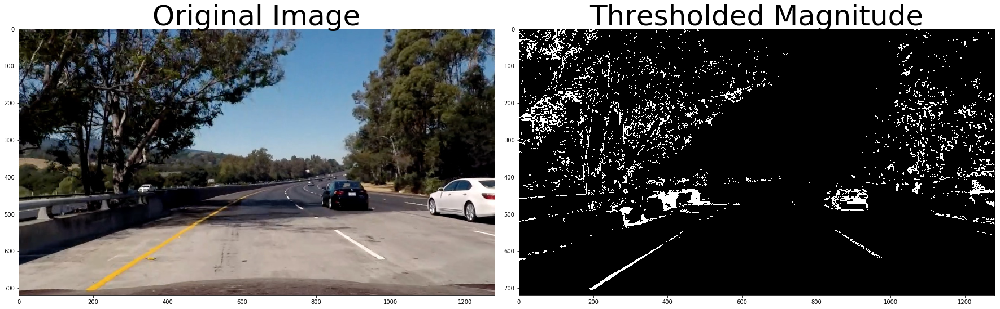

In [11]:
## try threshold for color threshold
color_thres = (200,256)

image = mping.imread("./test_images/test5.jpg")
image = cal_undistort(image, img_points, obj_points)
img_binary = hls_pip(image, thres_s=color_thres)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(img_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

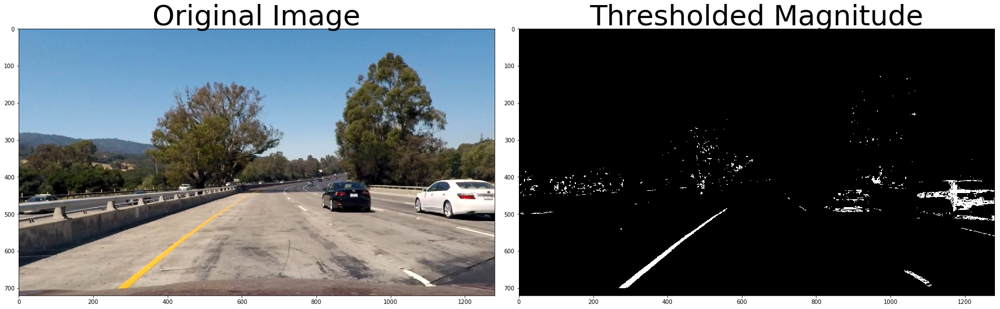

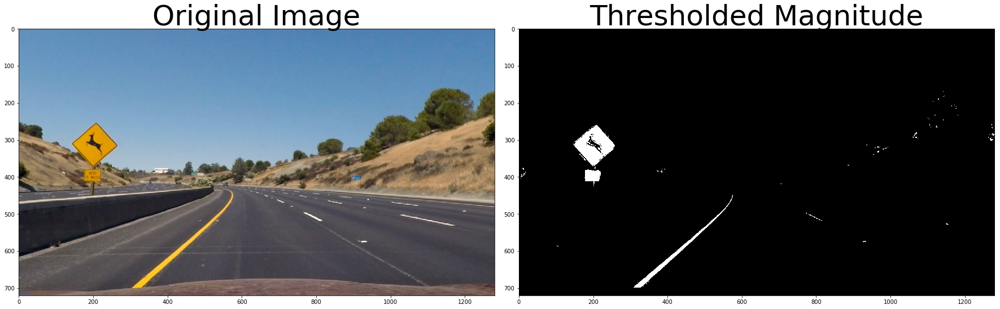

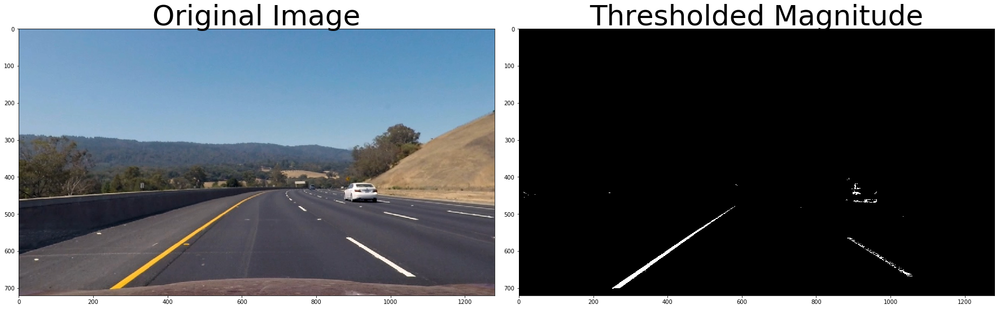

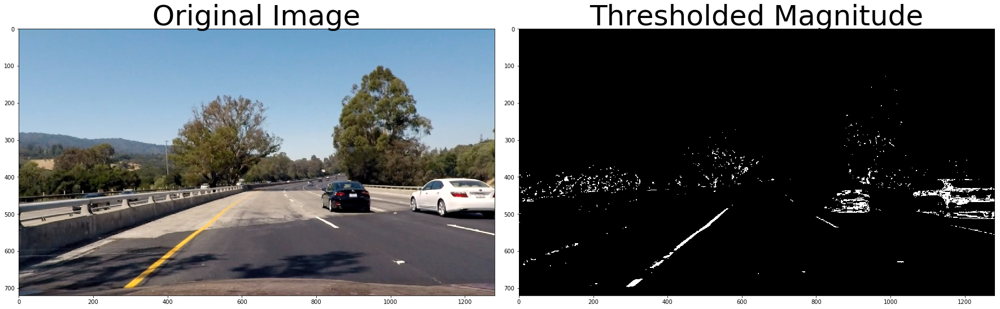

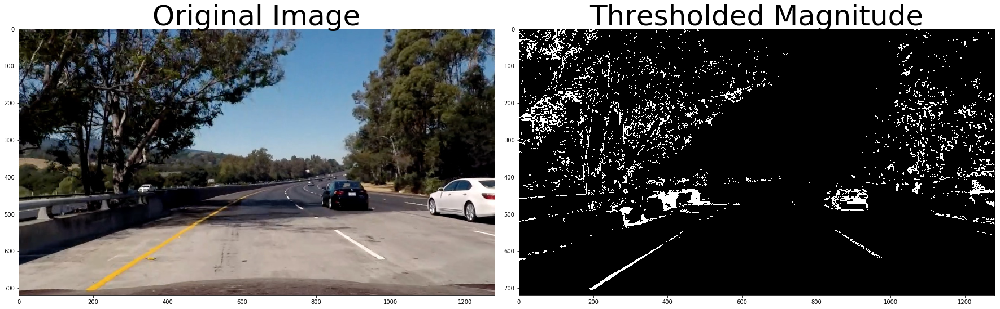

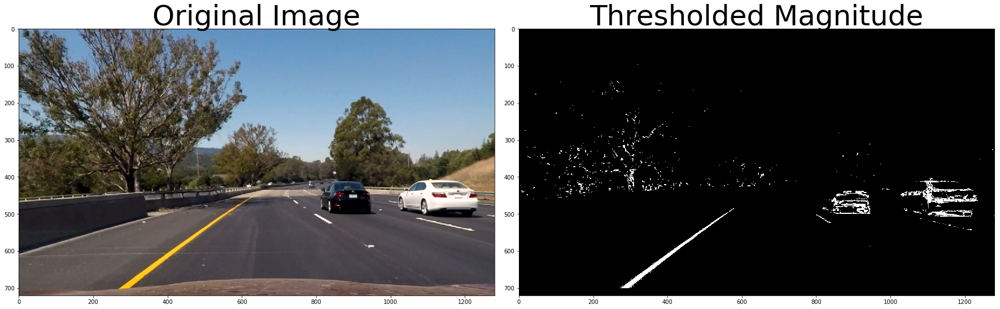

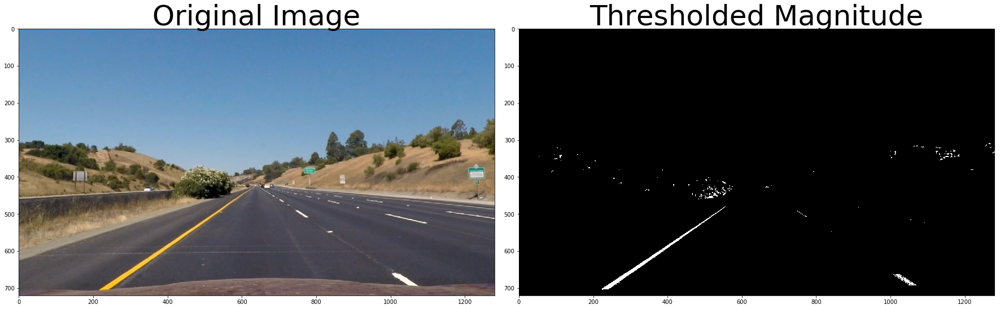

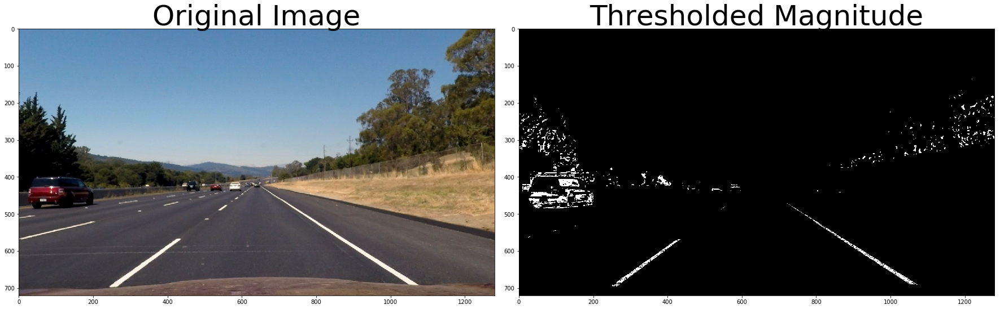

In [12]:
# test the function
for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    img_binary = hls_pip(image, thres_s=color_thres)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(img_binary, cmap='gray')
    ax2.set_title('Thresholded Magnitude', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig('./output_images/binary/hls_compare_' + figurename)

    cv2.imwrite('./output_images/binary/hls_' + figurename, img_binary*255)

### combine the grayscale and color channels threshold

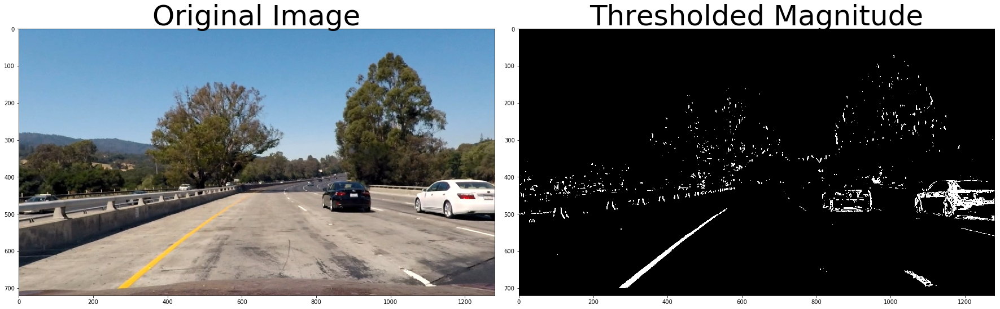

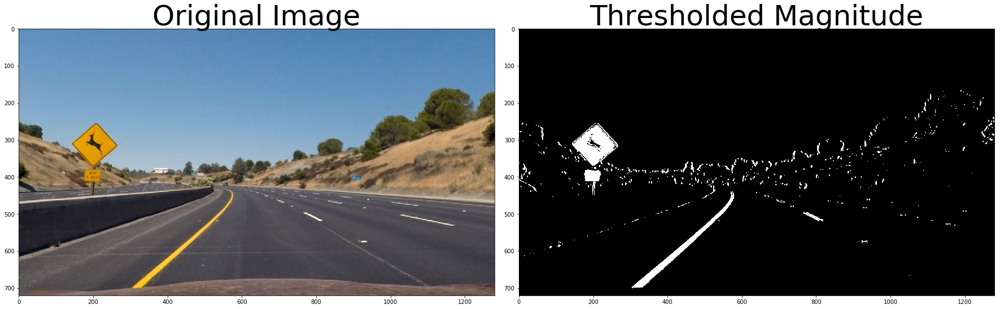

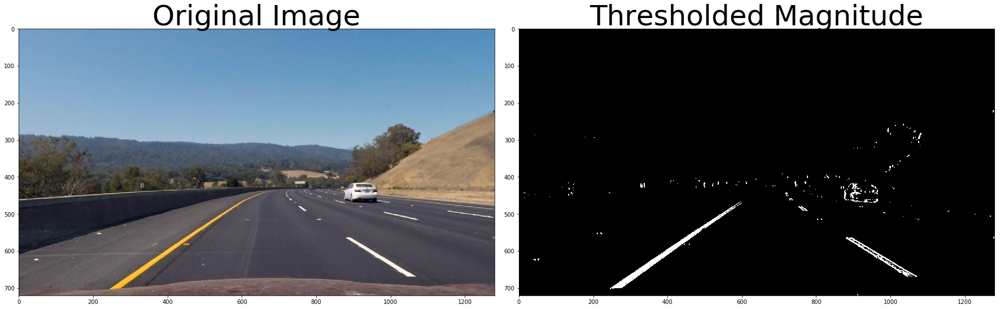

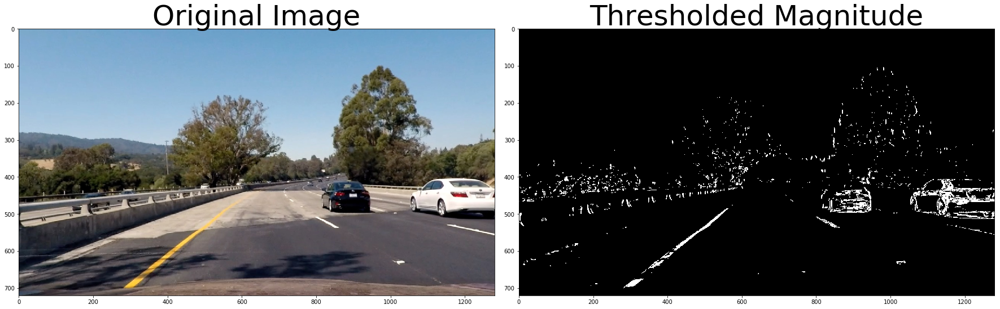

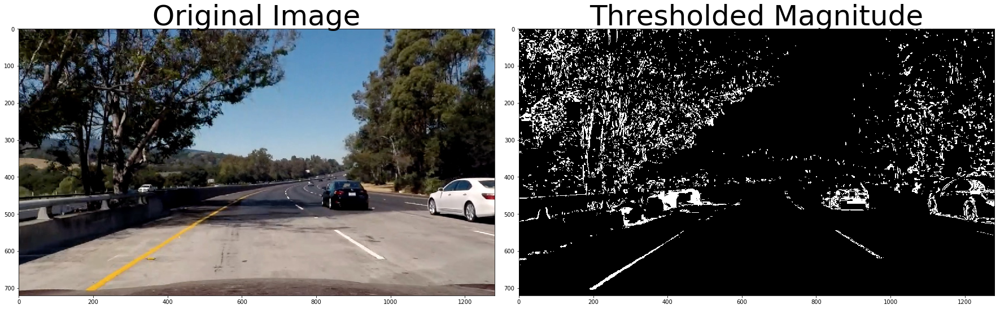

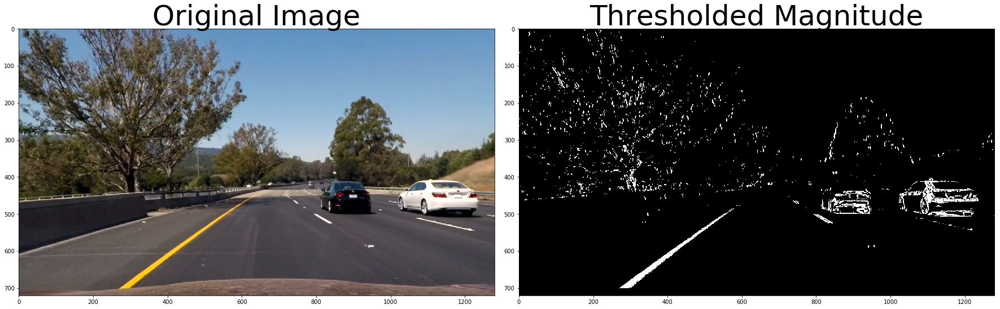

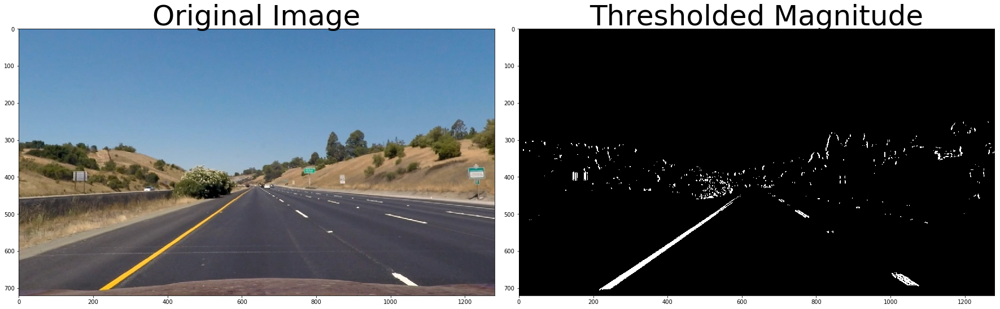

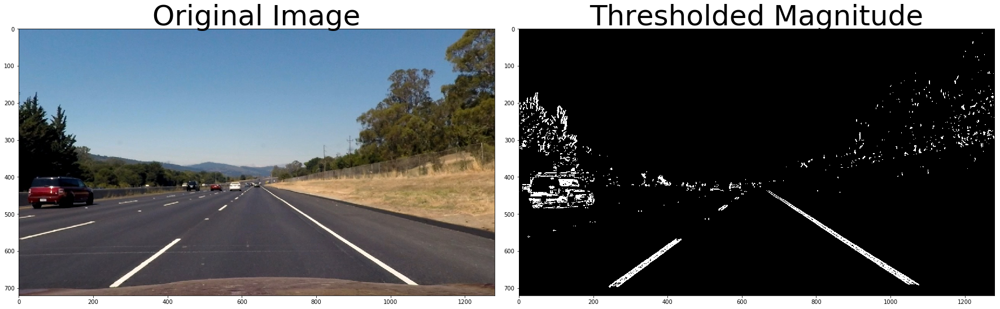

In [13]:
for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    img_binary = hls_pip(image, thres_s=color_thres)
    gray_binary = abs_sobel_binary(image, thres=gray_thres, sobel_kernel=9)

    binary_output = np.zeros_like(gray_binary)
    binary_output[(img_binary==1) | (gray_binary==1)] = 1
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(binary_output, cmap='gray')
    ax2.set_title('Thresholded Magnitude', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig('./output_images/binary/hls_compare_' + figurename)

    cv2.imwrite('./output_images/binary/hls_' + figurename, img_binary*255)

(720, 1280)


True

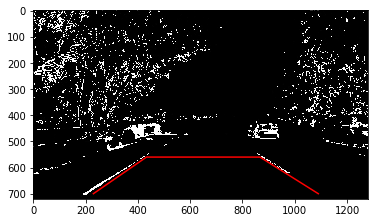

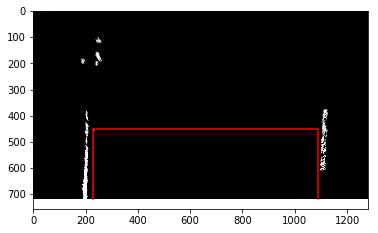

In [14]:
## convert it into bird-eye view

# read in the picture, undistort it and find the transform points
image = mping.imread('./output_images/binary/hls_test5.jpg')
plt.imshow(image, cmap='gray')


plt.plot(plot_point[0], plot_point[1], 'r')
plt.savefig("./output_images/binary/wrape_line.jpg")
print(image.shape)

plt.figure()
plt.imshow(wrap(image), cmap='gray')
plt.plot(wrap_point[0],wrap_point[1], 'r')
cv2.imwrite("./output_images/binary/wraped_straight_lines1.jpg", wrap(image))

## 4. generate the final pictures for finding the lane lines

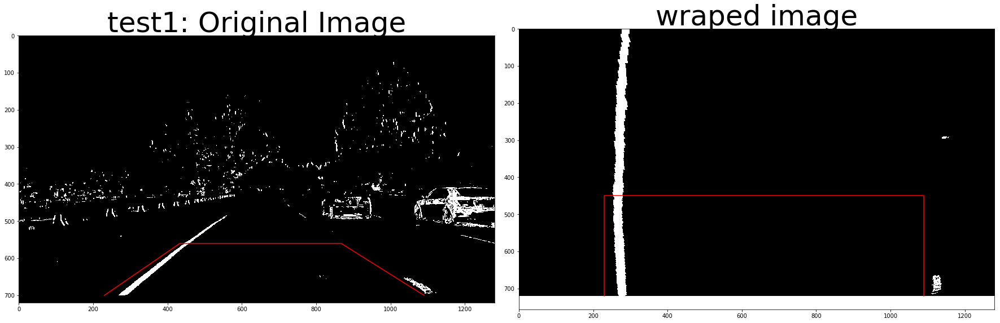

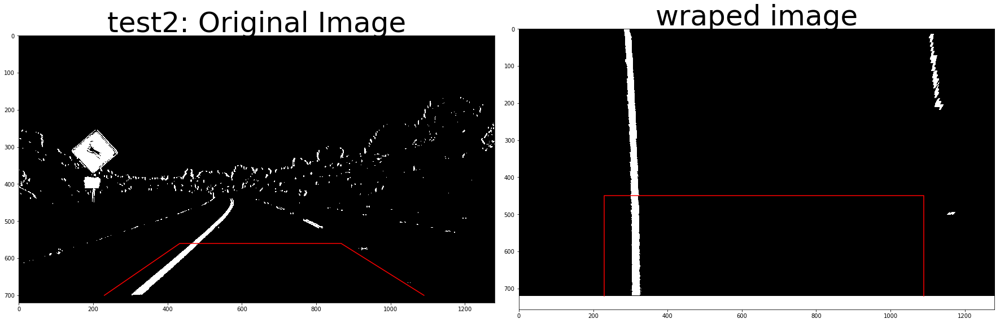

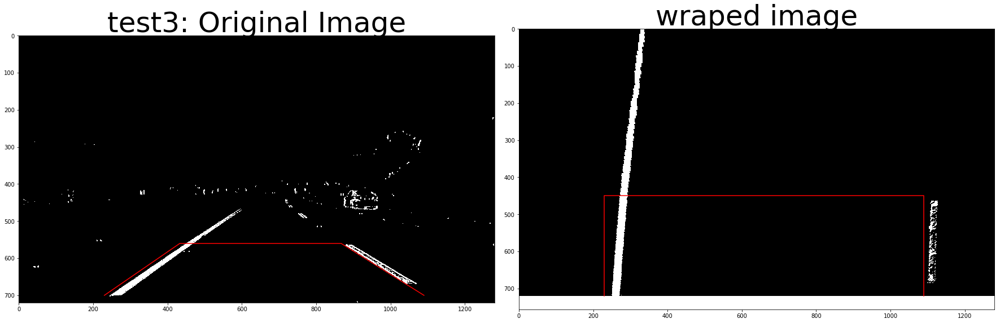

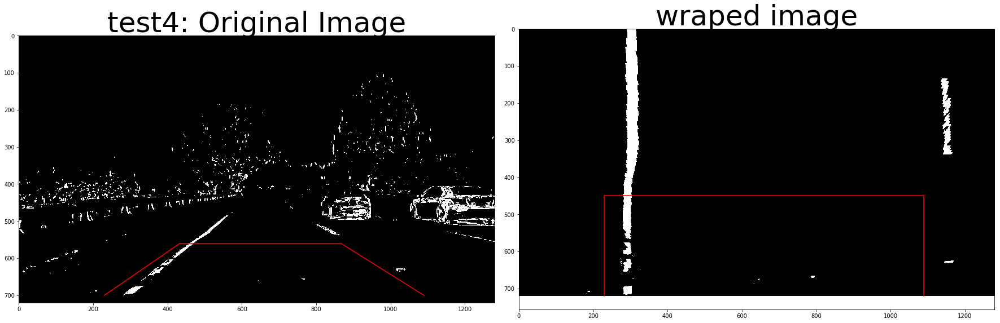

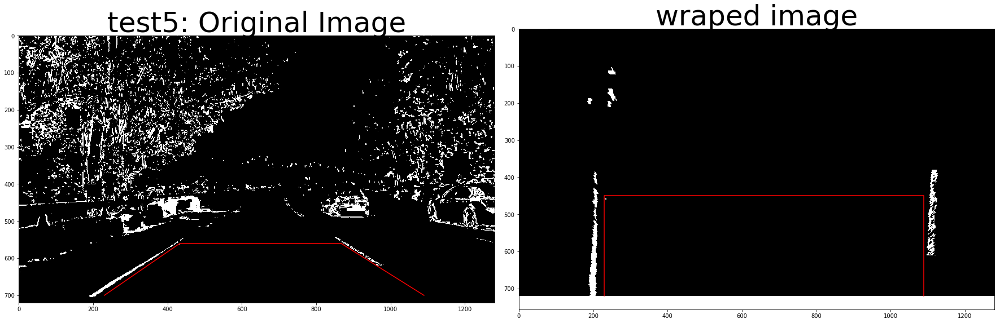

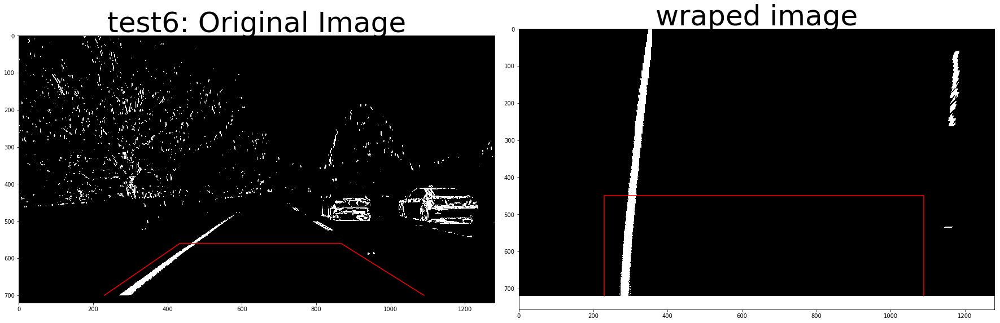

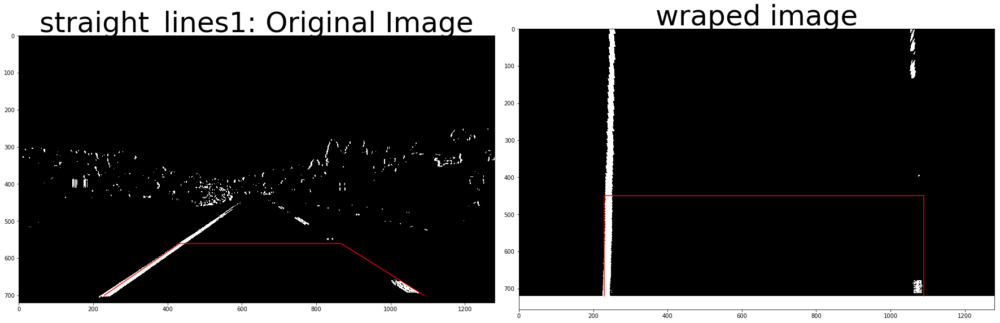

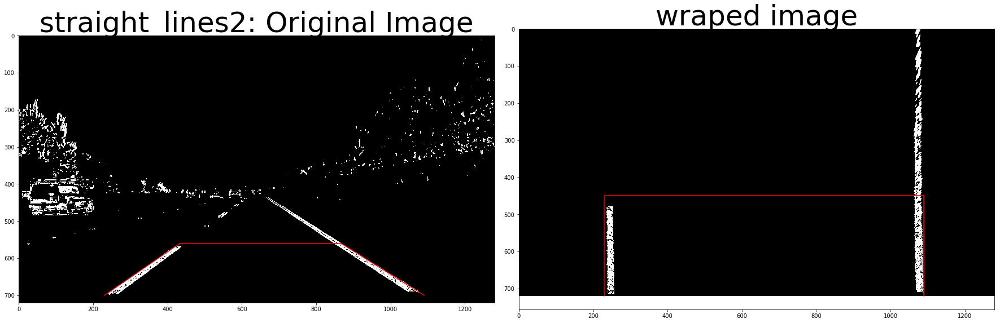

In [15]:
## read the files

for file in images:
    # read the image
    figurename = file.split('\\')[-1]
    image = mping.imread(file)
    # undistort the image
    image = cal_undistort(image, img_points, obj_points)
    # use sobel function, combine grayscale and color channels
    img_binary = hls_pip(image, thres_s=color_thres)
    gray_binary = abs_sobel_binary(image, thres=gray_thres, sobel_kernel=9)
    binary_output = np.zeros_like(gray_binary)
    binary_output[(img_binary==1) | (gray_binary==1)] = 1
    
    # convert the image into bird-eye view
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary_output, cmap='gray')
    ax1.plot(plot_point[0], plot_point[1], 'r')
    ax1.set_title(figurename.split('.')[0]+': Original Image', fontsize=50)
    ax2.imshow(wrap(img_binary), cmap='gray')
    ax2.plot(wrap_point[0],wrap_point[1], 'r')
    ax2.set_title('wraped image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    cv2.imwrite("./output_images/final_wrap/" + figurename, wrap(img_binary)*255)

## 5. Find the lane line

In this section I will find the lane lines by finding the peaks in a histogram and slide my window step by step.

In [36]:
# find lane line by histogram and make a visulization

def histogram_find(file, nwindows=9, margin=100, minpix=50):
    binary_wraped = mping.imread(file)
    figurename = file.split('\\')[-1]
    # take a histogram of bottom half of the image
    histogram = np.sum(binary_wraped[binary_wraped.shape[0]//2:,:], axis=0)
    # generate a picture to visualize the result
    out_image = np.dstack((binary_wraped,binary_wraped,binary_wraped))
    # find the peak of the histogram as the starting point
    mid_point = np.int(histogram.shape[0]//2)
    leftx_start = np.argmax(histogram[:mid_point])
    rightx_start = np.argmax(histogram[mid_point:]) + mid_point
    
    #set the height of the sliding window
    window_height = np.int(histogram.shape[0]//nwindows)
    # find all the nonzero pixels
    nonzero = binary_wraped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # define the current position
    leftx_current = leftx_start
    rightx_current = rightx_start
    # list to save the left and right positions of pixels in the form of index
    left_lane_inds = []
    right_lane_inds = []
    
    # slide the window
    for window in range(nwindows):
        # define the window boundaries
        win_y_low = binary_wraped.shape[0] - (1 + window) * window_height
        win_y_high = binary_wraped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # visualize the window
        cv2.rectangle(out_image,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_image,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        # find the nonzero pixel within the window in x and y
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                           (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # add the index into the list
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # relocate the center of the window if find > minpix pixels
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # visualization
    ploty = np.linspace(0, binary_wraped.shape[0]-1, binary_wraped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_image[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_image[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [255, 0, 0]
    plt.figure()
    plt.imshow(out_image)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.title(figurename, fontsize=50)
    
    # save the picture
#    plt.savefig('./output_images/histogram/'+figurename)
    return left_fit, right_fit

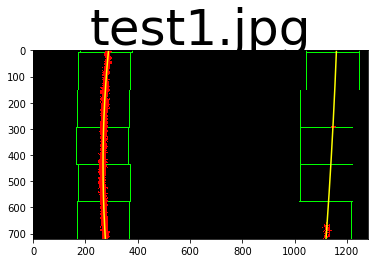

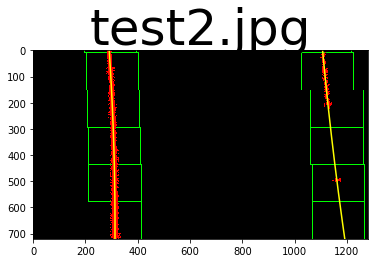

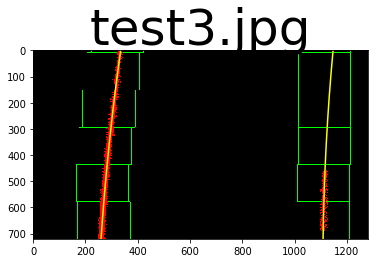

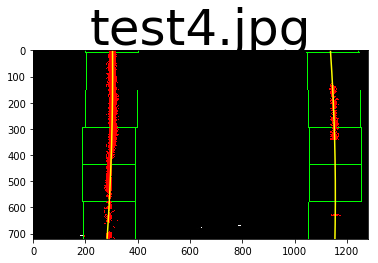

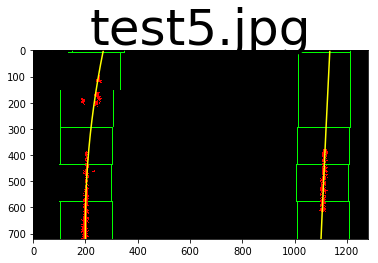

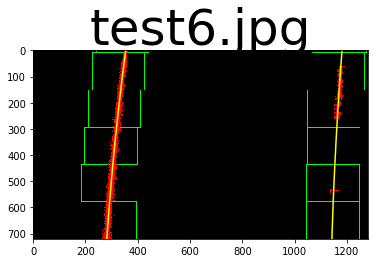

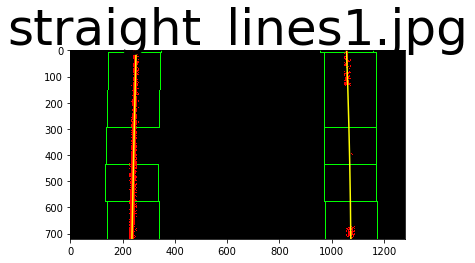

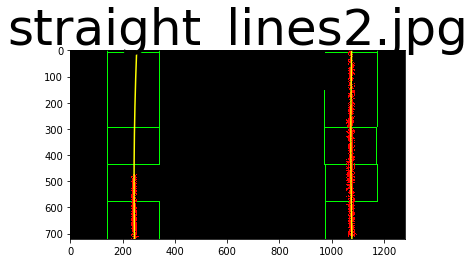

In [37]:
# test the function in each picture

files = glob.glob('./output_images/final_wrap/test*.jpg') + glob.glob('./output_images/final_wrap/straight_lines*.jpg')

for file in files:
    histogram_find(file)

In [45]:
## if I know the fit lines in one frame, in the next frame of video 
## I only need to search the line in the area near the fit lines

def precious_search(file, left_fit, right_fit,margin=100):
    figurename = file.split('\\')[-1]
    
    binary_wraped = mping.imread(file)
    nonzero = binary_wraped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_lane_inds = ((nonzerox > (left_fit[0] * nonzeroy ** 2 + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                     (nonzerox < (left_fit[0] * nonzeroy ** 2 + left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0] * nonzeroy ** 2 + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                     (nonzerox < (right_fit[0] * nonzeroy ** 2 + right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    leftx = nonzerox[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    ploty = np.linspace(0, binary_wraped.shape[0]-1, binary_wraped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    ## visualization
    out_img = np.dstack((binary_wraped, binary_wraped, binary_wraped))
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    plt.figure
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.savefig('./output_images/histogram/precious_'+figurename)
    
    return left_fit, right_fit

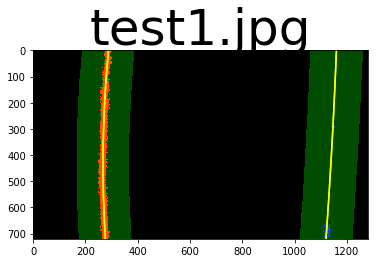

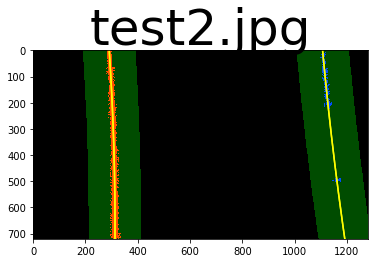

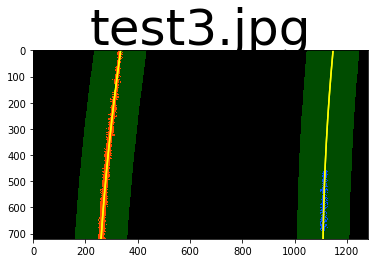

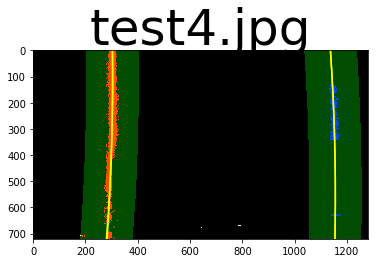

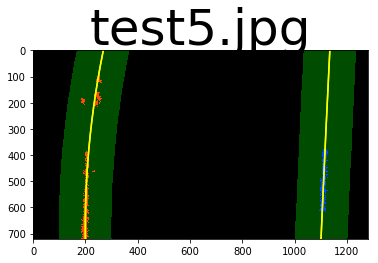

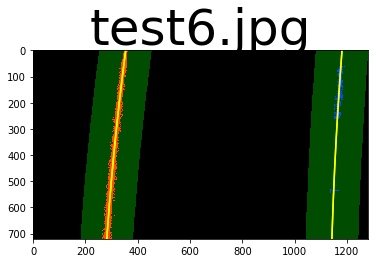

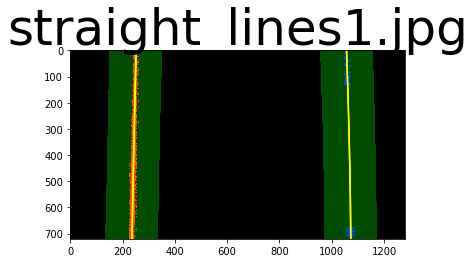

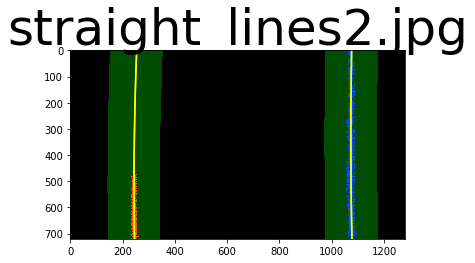

In [46]:
# test the function in each picture

for file in files:
    left_fit, right_fit = histogram_find(file)
    precious_search(file, left_fit, right_fit)